# Planetary Computer Data: SCALING TEST

In [ ]:
!mamba install -y py3dep
!mamba install -y astropy


                  __    __    __    __
                 /  \  /  \  /  \  /  \
                /    \/    \/    \/    \
███████████████/  /██/  /██/  /██/  /████████████████████████
              /  / \   / \   / \   / \  \____
             /  /   \_/   \_/   \_/   \    o \__,
            / _/                       \_____/  `
            |/
        ███╗   ███╗ █████╗ ███╗   ███╗██████╗  █████╗
        ████╗ ████║██╔══██╗████╗ ████║██╔══██╗██╔══██╗
        ██╔████╔██║███████║██╔████╔██║██████╔╝███████║
        ██║╚██╔╝██║██╔══██║██║╚██╔╝██║██╔══██╗██╔══██║
        ██║ ╚═╝ ██║██║  ██║██║ ╚═╝ ██║██████╔╝██║  ██║
        ╚═╝     ╚═╝╚═╝  ╚═╝╚═╝     ╚═╝╚═════╝ ╚═╝  ╚═╝

        mamba (0.22.1) supported by @QuantStack

        GitHub:  https://github.com/mamba-org/mamba
        Twitter: https://twitter.com/QuantStack

█████████████████████████████████████████████████████████████


Looking for: ['py3dep']

[+] 0.0s
[+] 0.1s
conda-forge/linux-64 ━━━━━━━━━━━━━━━╸━━━━━━━   0.0 B /  ??.?MB @  ??.

In [ ]:
import numpy as np
import pandas as pd
import geopandas as gpd
import rasterio as rio
import pystac
import pystac_client
import stackstac
import matplotlib.pyplot as plt
import xarray as xr
from datetime import datetime
import matplotlib
import ipyleaflet
import sys
import os
import dask_gateway
import planetary_computer
from rechunker import rechunk
sys.path.append('../sar_snowmelt_timing')
import s1_rtc_bs_utils
import contextily as ctx
import rioxarray as rxr
import skimage
from astropy.convolution import Gaussian2DKernel
from astropy.convolution import convolve

In [ ]:
os.environ["DASK_DISTRIBUTED__COMM__TIMEOUTS__CONNECT"]="300s"
os.environ["DASK_DISTRIBUTED__COMM__TIMEOUTS__TCP"]="800s"
os.environ["DASK_DISTRIBUTED__COMM__RETRY__DELAY__MIN"]="400s"
os.environ["DASK_DISTRIBUTED__COMM__RETRY__DELAY__MAX"]="600s"

In [ ]:
cluster = dask_gateway.GatewayCluster(shutdown_on_close=False) # 
client = cluster.get_client()
cluster.adapt(minimum=2, maximum=40)
print(client.dashboard_link)

In [ ]:
#gj = '../input/shapefiles/mt_baker.geojson'
gj = '../input/shapefiles/olympics.geojson'
#gj = '../input/shapefiles/olympic_peninsula.geojson'
#gj = '../input/shapefiles/wa.geojson'
bbox_gdf = gpd.read_file(gj)

In [ ]:
ts_ds = s1_rtc_bs_utils.get_s1_rtc_stac_pc(bbox_gdf,start_time='2019-01-01',end_time='2019-12-31',polarization='vv',resolution=40) # special incrimnets? 320.....   80 for peninsula, 40,30 works for olympics feb1-sept30 worked

In [ ]:
ts_ds

In [ ]:
#ts_ds = ts_ds.astype(np.float32)

In [11]:
ts_ds = ts_ds.compute()

In [12]:
runoffs = s1_rtc_bs_utils.get_runoff_onset(ts_ds,return_seperate_orbits=True)

[ 13  35  86 137]


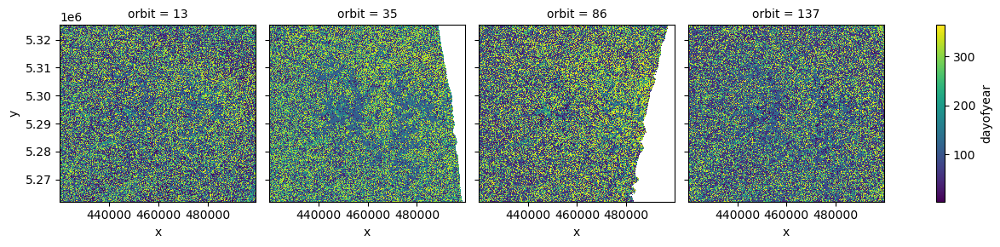

In [13]:
#f,ax=plt.subplots(figsize=(10,10))
runoffs.dt.dayofyear.plot(col='orbit')

In [14]:
#runoff_1 = runoffs.astype(np.int64)

In [15]:
#runoff_2 = runoff_1.where(runoff_1>0)

In [ ]:
#runoff_3 = runoff_2.median(axis=2,skipna=True)

In [ ]:
#runoff_4 = runoff_3.astype('datetime64[ns]')

In [16]:
runoffs = s1_rtc_bs_utils.get_runoff_onset(ts_ds,combine_orbits='median')

[ 13  35  86 137]


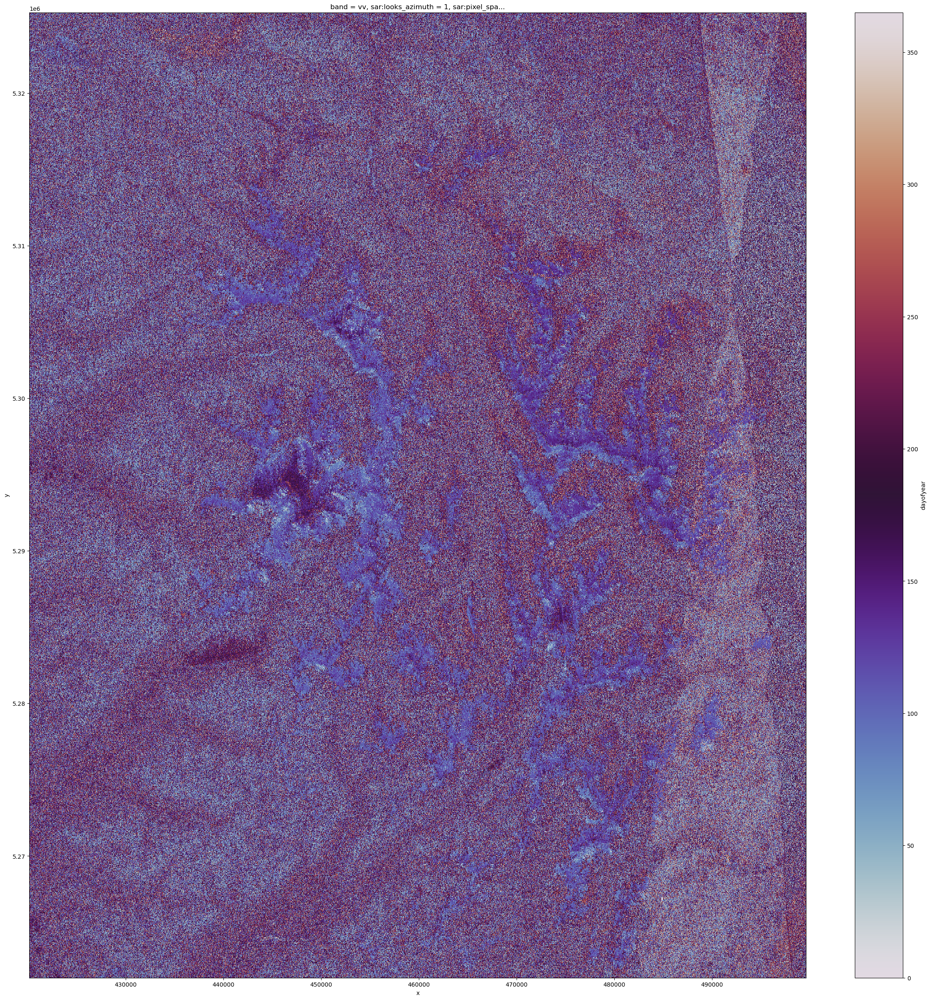

In [17]:
f,ax=plt.subplots(figsize=(30,30))
runoffs.dt.dayofyear.plot(ax=ax,vmin=0,vmax=365,cmap='twilight')

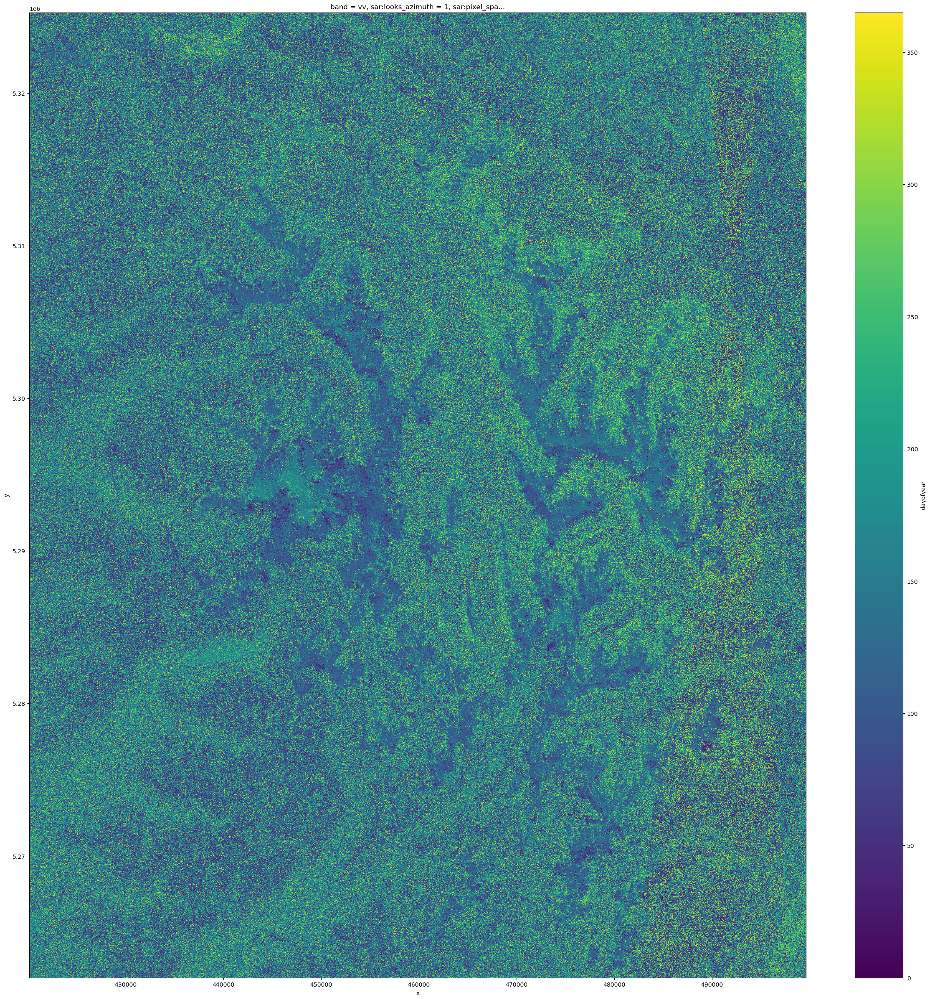

In [18]:
f,ax=plt.subplots(figsize=(30,30))
runoffs.dt.dayofyear.plot(ax=ax,vmin=0,vmax=365)

In [19]:
summer_ndvi_ds = s1_rtc_bs_utils.get_median_ndvi(ts_ds,start_time='2019-07-30',end_time='2019-09-09')

(5270000.0, 5320000.0)

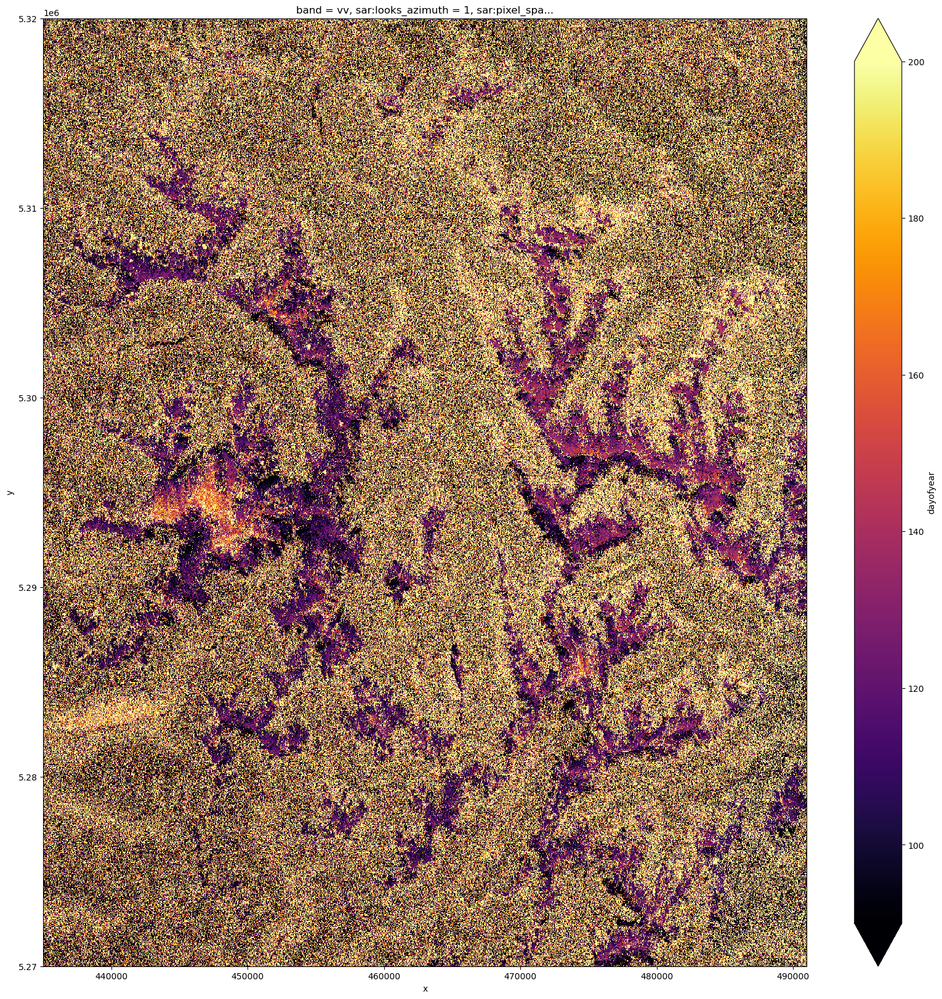

In [20]:
f,ax=plt.subplots(figsize=(20,20))
runoffs.where(summer_ndvi_ds<1).dt.dayofyear.plot(ax=ax,vmin=90,vmax=200,cmap='inferno')
ax.set_xlim([435000,491000])
ax.set_ylim([5.27E6,5.32E6])

In [21]:
#ndwi_median = s1_rtc_bs_utils.get_median_ndwi(ts_ds,start_time='2018-11-01',end_time='2019-03-16')
#summer_ndvi_ds = s1_rtc_bs_utils.get_median_ndvi(ts_ds,start_time='2019-07-30',end_time='2019-09-09')

In [22]:
#f,ax=plt.subplots(figsize=(30,30))
#ndwi_median.plot(ax=ax,cmap='RdBu')

In [23]:
cop30_dem_hs = rxr.open_rasterio('olympic_COP30_lzw-adj_proj_multi_hs.tif')

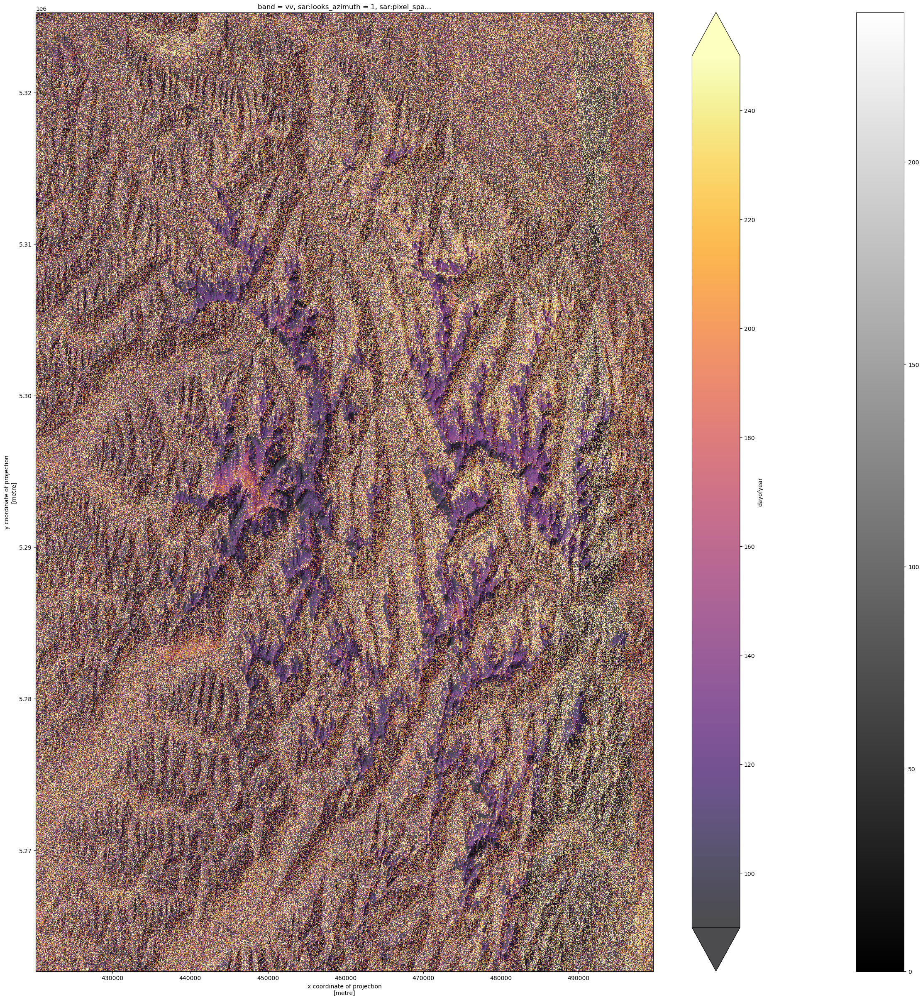

In [24]:
f,ax=plt.subplots(figsize=(30,30))
cop30_dem_hs.plot(ax=ax,cmap='gray',alpha=1)
runoffs.dt.dayofyear.plot(ax=ax,vmin=90,vmax=250,cmap='inferno',alpha=0.7)

In [25]:
summer_ndvi_ds.rio.crs

CRS.from_epsg(32610)

In [27]:
runoffs.rio.set_crs(summer_ndvi_ds.rio.crs)

<xarray.DataArray 'time' (y: 1582, x: 1987)>
array([['2019-03-03T08:15:19.902727424', '2019-08-02T02:25:06.887535104',
        '2019-11-13T20:11:28.324088832', ...,
        '2019-11-07T20:11:28.454715904', '2019-06-22T20:11:23.934807552',
        '2019-05-29T20:11:21.895848960'],
       ['2019-03-13T14:05:50.977177088', '2019-04-22T02:25:01.706205696',
        '2019-06-29T14:05:55.870121984', ...,
        '2019-10-14T20:11:28.355634432', '2019-05-29T20:11:23.656571392',
        '2019-03-18T20:11:19.628358144'],
       ['2019-03-30T20:11:19.549880832', '2019-09-29T08:15:27.615623680',
        '2019-09-03T14:05:59.409696000', ...,
        '2019-04-29T20:11:21.157338624', '2019-03-12T20:11:20.880795648',
        '2019-07-04T20:11:24.029900544'],
       ...,
       ['2019-07-17T14:05:44.285118976', '2019-08-10T14:05:45.433328640',
        '2019-07-01T08:15:23.848525312', ...,
        '2019-11-19T20:11:15.540366336', '2019-07-28T20:11:12.499821056',
        '2019-11-07T20:11:15.713107456'],
       ['2019-09-19T02:25:22.251761152', '2019-04-24T14:05:39.669156864',
        '2019-06-07T08:15:36.426968064', ...,
        '2019-08-03T20:11:11.151329024', '2019-04-23T20:11:08.710979584',
        '2019-03-12T20:11:07.858740224'],
       ['2019-06-05T14:05:41.755618816', '2019-04-24T14:05:39.886219520',
        '2019-06-15T02:25:17.190049792', ...,
        '2019-08-03T20:11:12.695934464', '2019-04-23T20:11:08.710979584',
        '2019-03-30T20:11:06.882959360']], dtype='datetime64[ns]')
Coordinates: (12/39)
    time                                   (y, x) datetime64[ns] 2019-02-24T1...
    id                                     (y, x) <U66 'S1B_IW_GRDH_1SDV_2019...
    band                                   <U2 'vv'
  * x                                      (x) float64 4.202e+05 ... 4.996e+05
  * y                                      (y) float64 5.325e+06 ... 5.262e+06
    sar:looks_azimuth                      int64 1
    ...                                     ...
    sar:observation_direction              <U5 'right'
    sar:frequency_band                     <U1 'C'
    raster:bands                           object {'nodata': -32768, 'data_ty...
    title                                  <U41 'VV: vertical transmit, verti...
    description                            <U173 'Terrain-corrected gamma nau...
    epsg                                   int64 32610

(435000.0, 491000.0, 5270000.0, 5320000.0)

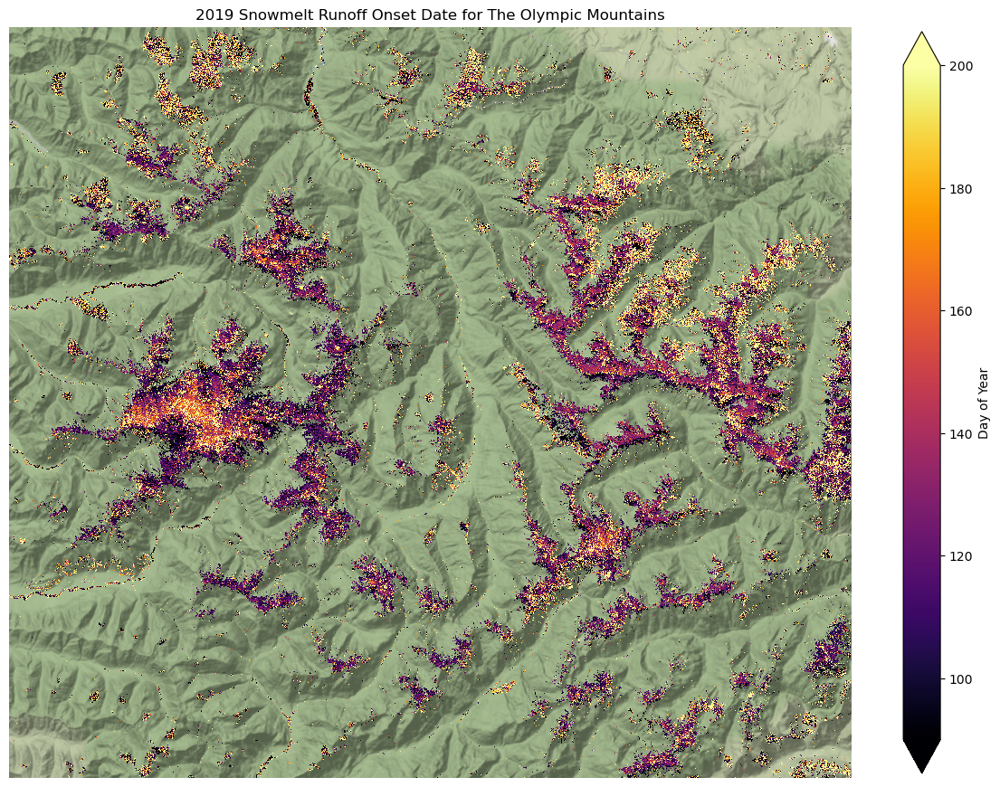

In [28]:
f,ax=plt.subplots(figsize=(15,15))
runoffs.where(summer_ndvi_ds<0.5).dt.dayofyear.plot(ax=ax,vmin=90,vmax=200,cmap='inferno',alpha=1,cbar_kwargs={'shrink':0.71,'label':'Day of Year'})
ax.set_xlim([435000,491000])
ax.set_ylim([5.27E6,5.32E6])
ctx.add_basemap(ax=ax, crs=runoffs.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)

ax.set_title('2019 Snowmelt Runoff Onset Date for The Olympic Mountains')
ax.set_aspect('equal')
ax.axis('off')

In [29]:
image_count = ts_ds.count(dim='time')
image_count_yearlyavg = 365.25/image_count

In [ ]:
f,ax=plt.subplots(figsize=(10,10))
image_count_yearlyavg.plot(ax=ax,vmin=0,vmax=13)

In [ ]:
ts_ds.where(summer_ndvi_ds<0.2).mean(dim=['x','y'])

In [ ]:
f,ax=plt.subplots()
ts_ds.where(summer_ndvi_ds<0.2).mean(dim=['x','y']).plot(ax=ax,x='time',hue='sat:orbit_state')
# trying to https://xarray.pydata.org/en/v0.10.1/auto_gallery/plot_lines_from_2d.html

In [ ]:
f,ax=plt.subplots(4,2,figsize=(30,30))
runoffs.where(summer_ndvi_ds<0.2).dt.dayofyear.plot(ax=ax[0,0],vmin=90,vmax=200,cmap='inferno')
ctx.add_basemap(ax=ax[0,0], crs=summer_ndvi_ds.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)

runoffs.where((summer_ndvi_ds>0.2)&(summer_ndvi_ds<0.5)).dt.dayofyear.plot(ax=ax[1,0],vmin=90,vmax=200,cmap='inferno')
ctx.add_basemap(ax=ax[1,0], crs=summer_ndvi_ds.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)

runoffs.where((summer_ndvi_ds>0.5)&(summer_ndvi_ds<0.82)).dt.dayofyear.plot(ax=ax[2,0],vmin=90,vmax=200,cmap='inferno')
ctx.add_basemap(ax=ax[2,0], crs=summer_ndvi_ds.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)

runoffs.where(summer_ndvi_ds>0.82).dt.dayofyear.plot(ax=ax[3,0],vmin=90,vmax=200,cmap='inferno')
ctx.add_basemap(ax=ax[3,0], crs=summer_ndvi_ds.rio.crs, source=ctx.providers.Stamen.Terrain, attribution=False)

#ts_ds.where(summer_ndvi_ds<0.2).groupby('sat:relative_orbit').mean(dim=['x','y']).plot(ax=ax[0,1])

In [ ]:
runoffs_std = s1_rtc_bs_utils.get_runoff_onset(ts_ds,return_seperate_orbits=True)

In [ ]:
runoffs_std.dt.dayofyear.plot(col='orbit',size=8,col_wrap=2,cmap='inferno')

In [ ]:
kernel = Gaussian2DKernel(x_stddev=1)
average_all_orbits = np.zeros([1582,1987])
for i in runoffs_std.orbit:
    astropy_conv = convolve(runoffs_std.sel(orbit=i).dt.dayofyear, kernel)
    average_all_orbits = astropy_conv+average_all_orbits
average_all_orbits = average_all_orbits/4

In [ ]:
f,ax=plt.subplots(figsize=(30,30))
runoff_date = ax.imshow(average_all_orbits,cmap='inferno',vmin=0,vmax=365)
f.colorbar(runoff_date,ax=ax)

In [ ]:
f,ax=plt.subplots(figsize=(10,10))
runoffs_std = runoffs_std.dt.dayofyear.std(dim='orbit')
runoffs_std.where(runoffs_std<60).plot(ax=ax,vmin=0,vmax=60)

In [ ]:
f,ax=plt.subplots()
runoffs.where(summer_ndvi_ds>0.5).dt.dayofyear.plot(ax=ax,vmin=90,vmax=200,cmap='inferno')

In [ ]:
from astropy.convolution import Gaussian2DKernel
from astropy.convolution import convolve

In [ ]:
kernel = Gaussian2DKernel(x_stddev=1.5)

In [ ]:
#astropy_conv = convolve(runoffs.where(summer_ndvi_ds>0.5).dt.dayofyear, kernel)
astropy_conv = convolve(runoffs.where((summer_ndvi_ds>0.5)&(summer_ndvi_ds<0.75)).dt.dayofyear, kernel)

In [ ]:
astropy_conv

In [ ]:
f,ax=plt.subplots(figsize=(10,10))
ax.imshow(astropy_conv,cmap='inferno',vmin=90,vmax=200)
ax.imshow(runoffs.where(summer_ndvi_ds<0.5).dt.dayofyear,cmap='inferno',vmin=90,vmax=200)

#runoffs.where(summer_ndvi_ds<0.5).dt.dayofyear.plot(ax=ax,vmin=90,vmax=200,cmap='inferno')

In [ ]:
ts_ds

In [ ]:
summer_ndvi_ds

In [ ]:
runoffs

In [ ]:
pixel_entropies = xr.apply_ufunc(skimage.measure.shannon_entropy,runoffs)

In [ ]:
#ts_ds = ts_ds.chunk({'time': 163,'y': 64,'x': 64})
#ts_ds = ts_ds.chunk({'time': 810,'y': 64,'x': 64})
#target_chunks = (163, 128, 128)
#max_mem = '1MB'
#target_store = 'air_rechunked.zarr'
#ts_ds = rechunk(ts_ds,target_chunks,max_mem,target_store)

In [ ]:
ts_ds

In [ ]:
#ts_ds.argmin(dim='time') #maybe dont need to do arg min?

In [ ]:
%%time
ts_ds = ts_ds.compute() # for Olympic Peninsula 0:5 works, 0:50 doesnt .isel(time=slice(0,25)) kernel restarts

In [ ]:
ts_ds

In [ ]:
%%time
ts_ds = ts_ds.dropna('time',how='all')

In [ ]:
ts_ds

In [ ]:
%%time
runoff = s1_rtc_bs_utils.get_runoff_onset(ts_ds,return_seperate_orbits=True).dt.dayofyear

In [ ]:
runoff

In [ ]:
runoff.plot(col='orbit')

In [ ]:
f,ax=plt.subplots()
runoff.plot(ax=ax,vmin=60,vmax=365)

In [ ]:
#### CODE FOR DEVELOPMENT-- THIS RELOADS s1_rtc_bs_utils MODULE
sys.modules.pop('s1_rtc_bs_utils')
import s1_rtc_bs_utils

In [ ]:
#!mamba install -y py3dep

#!mamba update -y dask-gateway
#!mamba update -y dask-distributed
#!mamba update -y dask

#from distributed import Client
#dask_gateway.config.set({"distributed.comm.timeouts.tcp": "120s"})
#os.environ["DASK_DISTRIBUTED__COMM__TIMEOUTS__CONNECT"]="100s"
#os.environ["DASK_DISTRIBUTED__COMM__TIMEOUTS__TCP"]="600s"
#os.environ["DASK_DISTRIBUTED__COMM__RETRY__DELAY__MIN"]="1s"
#os.environ["DASK_DISTRIBUTED__COMM__RETRY__DELAY__MAX"]="60s"



#dask_gateway.config.set({"distributed.comm.timeouts.tcp": "120s"})


# #gj = '../input/shapefiles/wa.geojson'

#f,ax=plt.subplots(figsize=(30,7))
#s1_rtc_bs_utils.plot_sentinel1_acquisitons(ts_ds,ax=ax)

#cluster.scale(10)
#cluster.adapt(minimum=400, maximum=400)
#gateway = Gateway()
#options = gateway.cluster_options()
#options.worker_cores = 100

#### CODE FOR DEVELOPMENT-- THIS RELOADS s1_rtc_bs_utils MODULE
#sys.modules.pop('s1_rtc_bs_utils')
#import s1_rtc_bs_utils